## Relative Value: Spread, Copula, Contra-Trend and XGB Approaches
#### King Wong

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
df = pd.read_csv("complete_tech_index_arbs.csv")


df['Date']= pd.to_datetime(df['Date'])
df.set_index('Date', inplace=True)
df.sort_index(inplace=True)
df = df[[col for col in df.columns if ('Close' in col) and ('Adj.' not in col)]]
df.columns = [" ".join(x[::-1]) for x in df.columns.str.split(' ').tolist()]
print(df.columns.tolist())

['Close XLK', 'Close AAPL', 'Close AMZN', 'Close MSFT', 'Close V', 'Close NVDA', 'Close MA', 'Close PYPL', 'Close ADBE', 'Close INTC', 'Close CRM', 'Close CSCO', 'Close ACN', 'Close AVGO', 'Close TXN', 'Close QCOM', 'Close ORCL', 'Close IBM', 'Close GOOG', 'Close FB', 'Close BABA']


In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
sec_ticker = set(t.split(' ')[-1] for t in df.columns.tolist() if 'XLK' not in t)

etf_ticker = 'XLK'
sec_ticker = list(sec_ticker)
sec_ticker

['PYPL',
 'CRM',
 'ACN',
 'CSCO',
 'INTC',
 'AVGO',
 'ORCL',
 'NVDA',
 'ADBE',
 'IBM',
 'QCOM',
 'AMZN',
 'BABA',
 'MSFT',
 'MA',
 'V',
 'FB',
 'TXN',
 'GOOG',
 'AAPL']

In [4]:
#@ daily returns

for ticker in sec_ticker + [etf_ticker]:
    df[f"ret {ticker}"] = df[f"Close {ticker}"].astype(float).pct_change(1)

In [5]:
## log price ratio and return beta
import statsmodels.api as sm

ratios = {}
for ticker in sec_ticker:
    temp = df[[f"Close {ticker}","Close XLK", f"ret {ticker}","ret XLK"]].dropna()
    ratio = sm.regression.linear_model.OLS(np.log(temp["Close XLK"]), np.log(temp[f"Close {ticker}"])).fit().params
    ratios[ticker] = ratio.values[0]
print(ratios)


{'PYPL': 0.9751502340400142, 'CRM': 0.8946606939604886, 'ACN': 0.8254120654353015, 'CSCO': 1.1237718364355669, 'INTC': 1.083189156630172, 'AVGO': 0.8136253202913192, 'ORCL': 1.0293858791900177, 'NVDA': 0.9407875370496339, 'ADBE': 0.8341487834674217, 'IBM': 0.7391257038814019, 'QCOM': 0.9127484493022409, 'AMZN': 0.5974713232931148, 'BABA': 0.836243076709611, 'MSFT': 0.9426029977673742, 'MA': 0.8383471582858399, 'V': 0.9007566633387994, 'FB': 0.8460257896114782, 'TXN': 0.9338401725762908, 'GOOG': 0.5974869044547648, 'AAPL': 0.8066878987756556}


In [6]:
def tValOLS(y):
    x = np.ones((len(y), 2))
    x[:,1] = np.arange(len(y))
    mols = sm.OLS(y,x).fit()
    return mols.tvalues[1]
def pValOLS(y):
    x = np.ones((len(y), 2))
    x[:,1] = np.arange(len(y))
    mols = sm.OLS(y,x).fit()
    return mols.pvalues[1]

In [7]:
## now we model the spread as r
from statsmodels.tsa.stattools import adfuller
from statsmodels.distributions.empirical_distribution import ECDF
from featGen import partial_derivative_Clayton

band_lookback = 30
trend_lookback = 5

prob_1 = 0.50
prob_2 = 1 - prob_1
    
for ticker in sec_ticker:
    df[f"r {ticker}"] = np.log(df["Close XLK"]) - ratios[ticker]*np.log(df[f"Close {ticker}"].astype(float))
    

    
    
    
    ## establish upper and lower bounds for binary signals as we model spread as normally distributed, 
    ## can use copula as well, to rank or for binary
    ## or even trend coefficient, to rank (a reflection point indicates trend reversion is near)
    
    ## 1. z score for spread(r)
    
    df[f"z_r {ticker}"] = (df[f"r {ticker}"] - df[f"r {ticker}"].rolling(band_lookback).mean())/ df[f"r {ticker}"].rolling(band_lookback).std()
    
    ## ADF test for stationarity 
    p_val = adfuller(df[f"z_r {ticker}"].dropna(), regression='c')[1]
    print(f"{ticker} to XLK p-val: {p_val}")
    
    df.loc[df[f"z_r {ticker}"]<=-1.645, f"mthd1_signal {ticker}"] = -1.0
    df.loc[df[f"z_r {ticker}"]>=1.645, f"mthd1_signal {ticker}"] = 1.0
    
    ## 2. copula
    kendalls_tau = df[f"ret {ticker}"].corr(df[f"ret XLK"], method='kendall')
    ecdf_sec_func, ecdf_etf_func = ECDF(df[f"ret {ticker}"].values), ECDF(df[f"ret XLK"].values)
    df[f"u {ticker}"] = df[f"ret {ticker}"].apply(ecdf_sec_func)
    df[f"v {ticker}"] = df[f"ret XLK"].apply(ecdf_etf_func)
    df[f"prob_etf_pipe_sec {ticker}"] = partial_derivative_Clayton(df[f"u {ticker}"].values, df[f"v {ticker}"].values,
                                                                   kendalls_tau)
    df[f"prob_sec_pipe_etf {ticker}"] = partial_derivative_Clayton(df[f"v {ticker}"].values, df[f"u {ticker}"].values,
                                                                   kendalls_tau)
    ## the probabilities can be quantile and ranked, but binary signal can be constructed as well                                    
    df.loc[(df[f"prob_sec_pipe_etf {ticker}"] > prob_1) & (df[f"prob_etf_pipe_sec {ticker}"] < prob_2),f"mthd2_signal {ticker}"] =-1 ## long etf, short stock
    df.loc[(df[f"prob_etf_pipe_sec {ticker}"] > prob_1) & (df[f"prob_sec_pipe_etf {ticker}"] < prob_2),f"mthd2_signal {ticker}"] =1 ## short etf, long stock
                                    
    ## 3. trend stats, t statistic of the trend, 
    ## take trading position if there's discontinuing the current trend/reflection point
    df[f"5dtrend_p_val {ticker}"] = df[f"r {ticker}"].rolling(trend_lookback).apply(pValOLS)
    df[f"5dtrend_t_val {ticker}"] = df[f"r {ticker}"].rolling(trend_lookback).apply(tValOLS)
    df[f"prev_5dtrend_t_val {ticker}"] = df[f"5dtrend_t_val {ticker}"].shift(1)
    df.loc[(df[f"5dtrend_p_val {ticker}"]> 0.10) & (df[f"prev_5dtrend_t_val {ticker}"]< 0) , f"mthd3_signal {ticker}"] = -1
    df.loc[(df[f"5dtrend_p_val {ticker}"]> 0.10) & (df[f"prev_5dtrend_t_val {ticker}"]> 0) , f"mthd3_signal {ticker}"] = 1
        
                                    

PYPL to XLK p-val: 4.618015907392458e-13
CRM to XLK p-val: 9.2615304102238e-19
ACN to XLK p-val: 3.5379257698389245e-20
CSCO to XLK p-val: 1.587250280676134e-22
INTC to XLK p-val: 4.378984259082413e-19
AVGO to XLK p-val: 6.823794462733933e-22
ORCL to XLK p-val: 6.948858068406193e-20
NVDA to XLK p-val: 1.0042166151575242e-20
ADBE to XLK p-val: 1.2392021351538216e-21
IBM to XLK p-val: 1.1033525621611577e-18
QCOM to XLK p-val: 1.4832120308239402e-23
AMZN to XLK p-val: 1.5430951054951116e-16
BABA to XLK p-val: 1.147236267380115e-09
MSFT to XLK p-val: 4.950484522323116e-22
MA to XLK p-val: 2.2290286354565543e-21
V to XLK p-val: 5.570886889002794e-19
FB to XLK p-val: 8.33491673471099e-15
TXN to XLK p-val: 8.063416752166793e-22
GOOG to XLK p-val: 8.311659833488255e-13
AAPL to XLK p-val: 9.435028171437506e-21


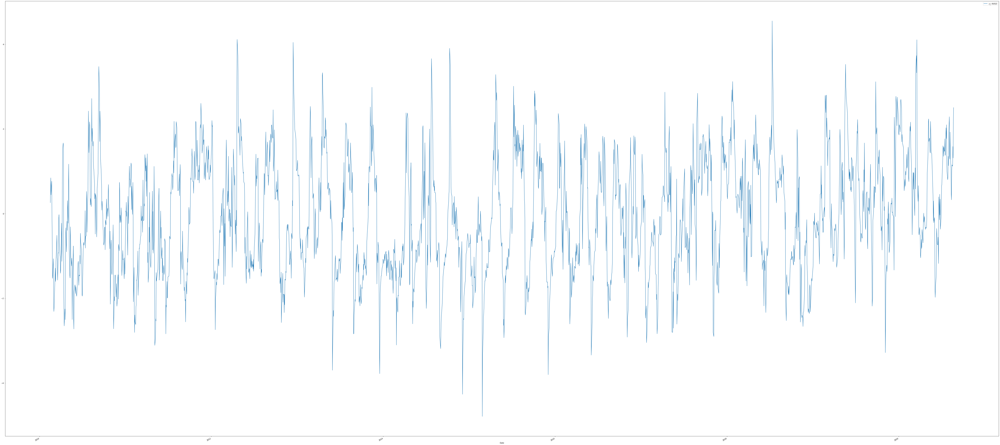

In [8]:
df['z_r AVGO'].plot(figsize=(100,50), legend=True)

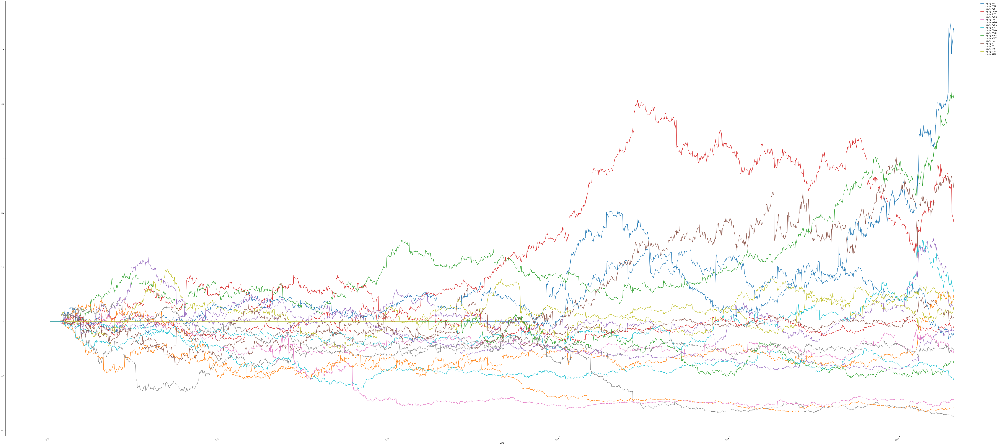

In [9]:
## backtest mthd 1

## tiny backtester
## enter and exit trade when signal reversed (1 to -1)

for ticker in sec_ticker:
    bt_df = df.copy()
    bt_df[f"holding {ticker}"] = bt_df[f"mthd1_signal {ticker}"].ffill().shift(1)
    bt_df[f"port_ret {ticker}"] = (bt_df[f"ret {ticker}"]- bt_df[f"ret XLK"])*bt_df[f"holding {ticker}"]

    bt_df[f"port_ret {ticker}"] = bt_df[f"port_ret {ticker}"].fillna(0)
    bt_df[f"equity {ticker}"] = (bt_df[f"port_ret {ticker}"] + 1).cumprod()
    
    bt_df[f"equity {ticker}"].plot(figsize=(100,50), legend=True)
            

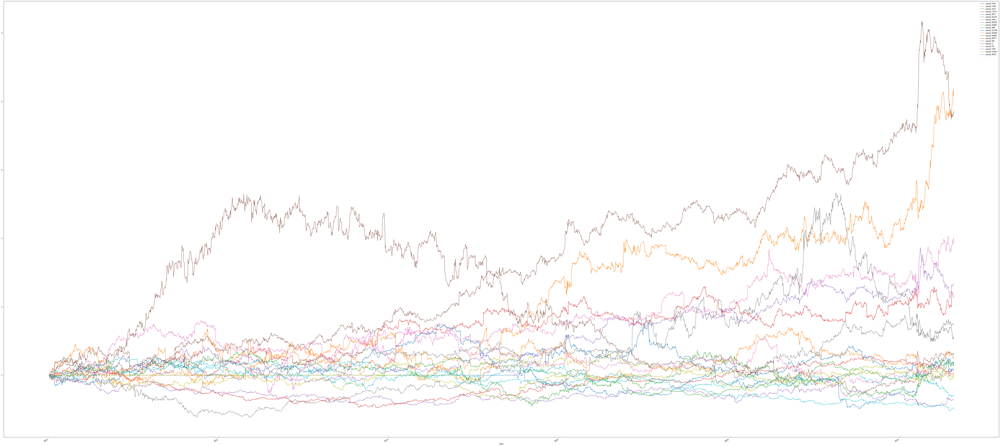

In [10]:
## backtest mthd 2

## tiny backtester
## enter and exit trade when signal reversed (1 to -1)

for ticker in sec_ticker:
    bt_df = df.copy()
    bt_df[f"holding {ticker}"] = bt_df[f"mthd2_signal {ticker}"].ffill().shift(1)
    bt_df[f"port_ret {ticker}"] = (bt_df[f"ret {ticker}"] - bt_df[f"ret XLK"])*bt_df[f"holding {ticker}"]

    bt_df[f"port_ret {ticker}"] = bt_df[f"port_ret {ticker}"].fillna(0)
    bt_df[f"equity {ticker}"] = (bt_df[f"port_ret {ticker}"] + 1).cumprod()
    
    bt_df[f"equity {ticker}"].plot(figsize=(100,50), legend=True)
    

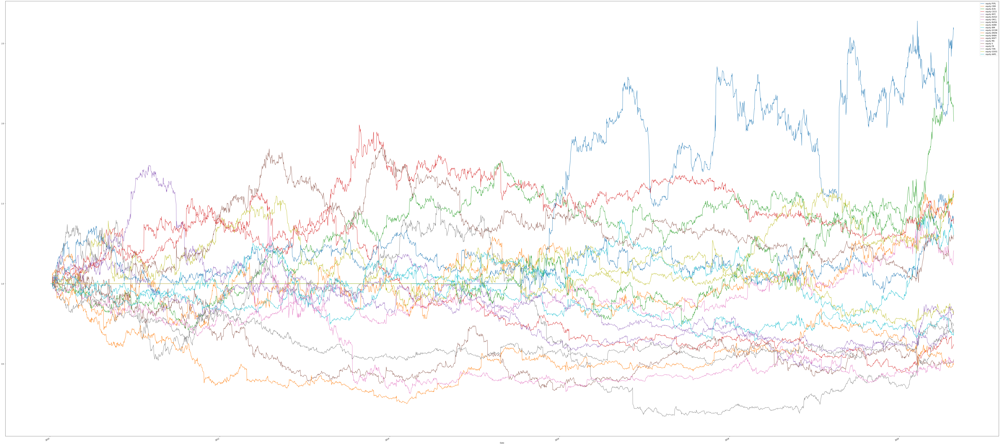

In [11]:
## backtest mthd 3

## tiny backtester
## enter and exit trade when signal reversed (1 to -1)

for ticker in sec_ticker:
    bt_df = df.copy()
    bt_df[f"holding {ticker}"] = bt_df[f"mthd3_signal {ticker}"].ffill().shift(1)
    bt_df[f"port_ret {ticker}"] = (bt_df[f"ret {ticker}"] - bt_df[f"ret XLK"])*bt_df[f"holding {ticker}"]

    bt_df[f"port_ret {ticker}"] = bt_df[f"port_ret {ticker}"].fillna(0)
    bt_df[f"equity {ticker}"] = (bt_df[f"port_ret {ticker}"] + 1).cumprod()
    
    bt_df[f"equity {ticker}"].plot(figsize=(100,50), legend=True)
    

In [12]:
## Portfolio construction

## we can rank pairs based on 
## 1. the spread for mthd1
## 2. conditional prob/ partial_derivative_Clayton for mthd2
## 3. max(1/(+ve trend t val), 1/abs(-ve trend t val)) for mthd3


## we then long the 70% quantile and short 30% quantile of the pairs
## we rebalance daily for now, can be weekly

df_port = df.copy()

        
df_port.columns = df_port.columns.str.split(' ', expand=True)  
df_port = df_port.stack()
df_port = df_port.reset_index(level=[0,1])
df_port.rename({'level_1':'ticker'}, axis='columns', inplace=True)
df_port.set_index('Date', inplace=True)

In [13]:
def wQuantilePort(signal_row):
    '''
    Quantile equal weighting portfolio
    go long the top securities with w = 1/len_long
    and short the bottom securities with w = −1/len_short
    '''
    w = pd.Series(index=signal_row.index, name=signal_row.name)
    signal_row = signal_row.dropna()
    long = signal_row.quantile(0.7)
    short = signal_row.quantile(0.3)
    
    long = signal_row[signal_row > long].index
    short = signal_row[signal_row < short].index
    
    
    w.loc[long] = 1/len(long) if len(long) >0 else 0
    w.loc[short] = -1/len(short) if len(short) >0 else 0
    return w

In [14]:
def wEqualPort(signal_row):
    '''
    Equal weighting portfolio
    go long the securities with w = 1/len_long
    and short the securities with w = −1/len_short
    '''
    w = pd.Series(index=signal_row.index, name=signal_row.name)
    signal_row = signal_row.dropna()
    
    long = signal_row[signal_row > 0].index
    short = signal_row[signal_row < 0].index
    
    
    w.loc[long] = 1/len(long) if len(long) >0 else 0
    w.loc[short] = -1/len(short) if len(short) >0 else 0
    return w

In [15]:
def dd(ts):
    return np.min(ts / np.maximum.accumulate(ts)) - 1

/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys


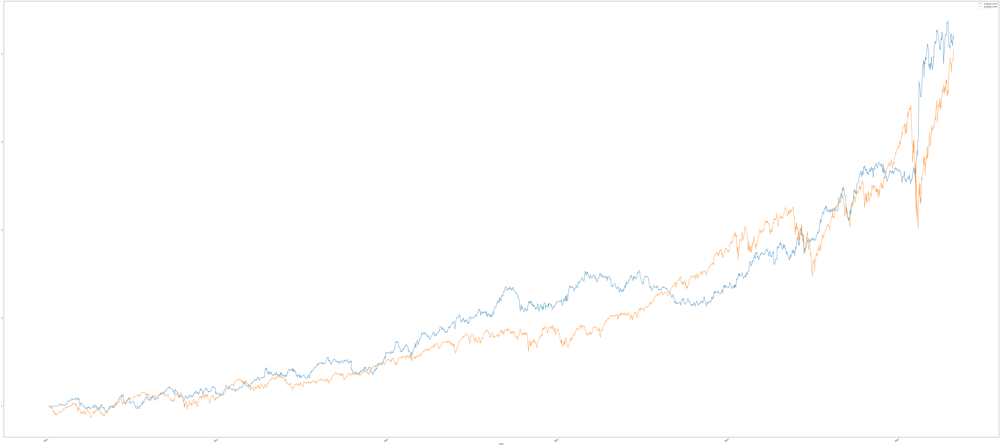

In [16]:
## mthd1 factor portfolio
## long highest spread, short lowest spread
## need to cache target weighting as it would earn next day returns 
port_rets =[]
cached_w = df_port.loc[df_port.index.unique()[0]][['ticker']].set_index('ticker')
cached_w['w'] = 0
cached_w = cached_w.squeeze()


for date in df_port.index.unique():
    ret = df_port.loc[date][['ticker','ret']]
    etf_ret = ret[ret['ticker']=='XLK']['ret'].values[0]
    port_ret = np.sum((ret.set_index('ticker').squeeze().rename(date)- etf_ret)*cached_w)
    port_rets.append(port_ret)
    
    cached_w = wQuantilePort(df_port.loc[date][['ticker','z_r']].set_index('ticker').squeeze())

mthd1_quantile_port =  pd.DataFrame(index=df_port.index.unique())   
mthd1_quantile_port['port_ret'] = port_rets
mthd1_quantile_port['port_ret'] = mthd1_quantile_port['port_ret'].fillna(0)

mthd1_quantile_port['b_ret'] =df['ret XLK'].fillna(0)



mthd1_quantile_port['p_equity_curve'] = (mthd1_quantile_port['port_ret'] + 1).cumprod()
mthd1_quantile_port['b_equity_curve'] =(mthd1_quantile_port['b_ret'] + 1).cumprod()

mthd1_quantile_port[['p_equity_curve','b_equity_curve']].plot(figsize=(100,50), legend=True)




In [17]:
def performance_analysis(port_performance_df):
    port_performance_df['port_ret'].plot(figsize=(100,50), legend=True)
    ## End Equity
    print("Ending Equity/ Profitability")
    print(port_performance_df['p_equity_curve'].tail(1))
    ## Portfolio Return
    plt.show()
    plt.close()
    print(port_performance_df['port_ret'].describe())
    
    print('strategy alpha beta')
    res = sm.OLS(port_performance_df['port_ret'], sm.add_constant(port_performance_df['b_ret'])).fit()
    print(res.summary())
    ## Max Drawdown
    port_performance_df['p_equity_curve'].rolling(126).apply(dd).plot(figsize=(100,50), legend=True)
    plt.show()
    plt.close()
    print(f"max dd: {min(port_performance_df['p_equity_curve'].rolling(126).apply(dd).dropna())}")
    ## Annualised Information Ratio

    yr_ret_port_df = port_performance_df['p_equity_curve'].resample('1y').first().pct_change(1)
    yr_ret_b_df = port_performance_df['b_equity_curve'].resample('1y').first().pct_change(1)
    annual_std = port_performance_df['p_equity_curve'].pct_change(252).resample('1y').std()

    annual_IR = (yr_ret_port_df- yr_ret_b_df) / annual_std
    annual_IR
    print("IR")
    print(annual_IR)
    print(np.mean(annual_IR))
    
    

Ending Equity/ Profitability
Date
2020-08-21    5.164079
Name: p_equity_curve, dtype: float64


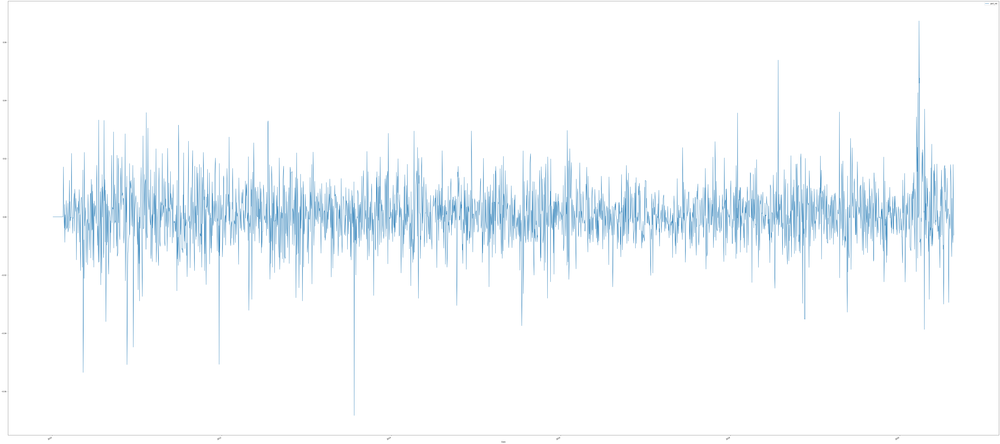

count    2678.000000
mean        0.000660
std         0.009682
min        -0.068251
25%        -0.004549
50%         0.000447
75%         0.005920
max         0.067326
Name: port_ret, dtype: float64
strategy alpha beta
                            OLS Regression Results                            
Dep. Variable:               port_ret   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.006
Method:                 Least Squares   F-statistic:                     18.22
Date:                Sat, 22 Aug 2020   Prob (F-statistic):           2.04e-05
Time:                        07:52:10   Log-Likelihood:                 8628.9
No. Observations:                2678   AIC:                        -1.725e+04
Df Residuals:                    2676   BIC:                        -1.724e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                 

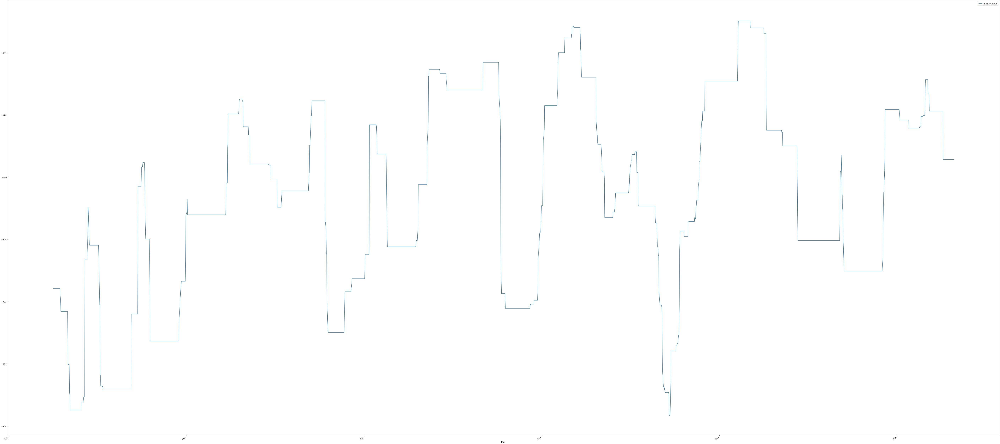

max dd: -0.15659485992866218
IR
Date
2010-12-31         NaN
2011-12-31   -0.784876
2012-12-31    1.479294
2013-12-31    0.216805
2014-12-31    0.037045
2015-12-31    0.919415
2016-12-31    1.582113
2017-12-31   -0.518966
2018-12-31   -3.559786
2019-12-31    4.694988
2020-12-31   -1.522476
Freq: A-DEC, dtype: float64
0.2543556666841867


In [18]:
performance_analysis(mthd1_quantile_port)

/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys


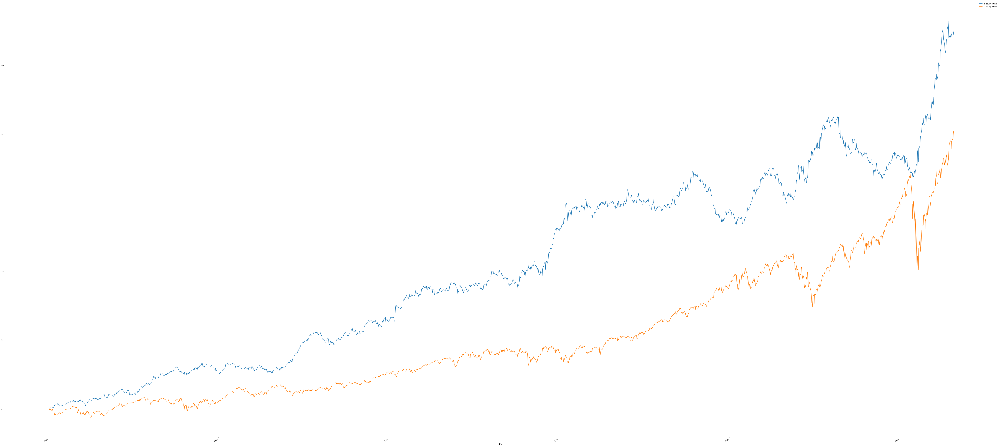

In [19]:
## mthd2 factor portfolio
## long highest spread bw the two cond probs, short lowest spread


port_rets =[]
cached_w = df_port.loc[date][['ticker']].set_index('ticker')
cached_w['w'] = 0
cached_w = cached_w.squeeze()


for date in df_port.index.unique():
    ret = df_port.loc[date][['ticker','ret']]
    etf_ret = ret[ret['ticker']=='XLK']['ret'].values[0]
    port_ret = np.sum((ret.set_index('ticker').squeeze().rename(date)- etf_ret)*cached_w)
    
    port_rets.append(port_ret)
    
    probs_spd =  df_port.loc[date][['ticker','prob_etf_pipe_sec']].set_index('ticker').squeeze().rename(date) - df_port.loc[date][['ticker','prob_sec_pipe_etf']].set_index('ticker').squeeze().rename(date)
    
    # print(probs_spd)
    
    
    cached_w = wQuantilePort(probs_spd)
    

mthd2_quantile_port =  pd.DataFrame(index=df_port.index.unique())   
mthd2_quantile_port['port_ret'] = port_rets
mthd2_quantile_port['port_ret'] = mthd2_quantile_port['port_ret'].fillna(0)


mthd2_quantile_port['b_ret'] =df['ret XLK'].fillna(0)



mthd2_quantile_port['p_equity_curve'] = (mthd2_quantile_port['port_ret'] + 1).cumprod()
mthd2_quantile_port['b_equity_curve'] =(mthd2_quantile_port['b_ret'] + 1).cumprod()

mthd2_quantile_port[['p_equity_curve','b_equity_curve']].plot(figsize=(100,50), legend=True)

Ending Equity/ Profitability
Date
2020-08-21    6.489613
Name: p_equity_curve, dtype: float64


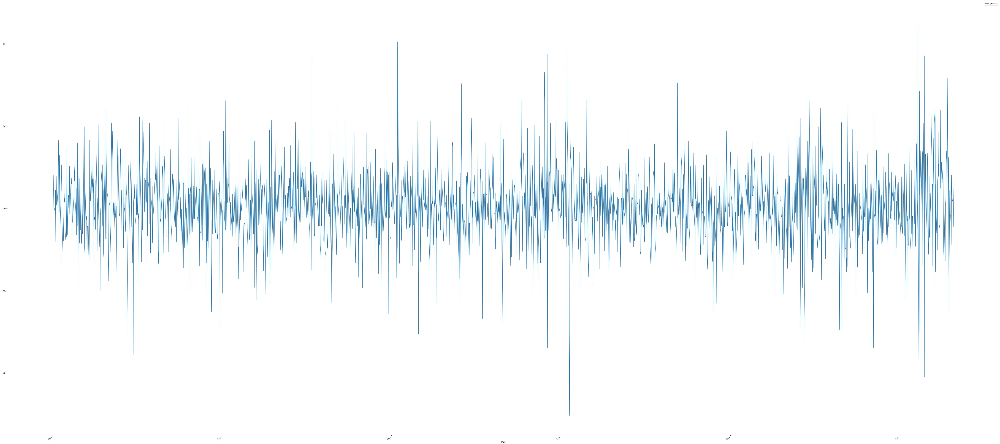

count    2678.000000
mean        0.000735
std         0.008483
min        -0.050333
25%        -0.004093
50%         0.000716
75%         0.005337
max         0.045604
Name: port_ret, dtype: float64
strategy alpha beta
                            OLS Regression Results                            
Dep. Variable:               port_ret   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     20.93
Date:                Sat, 22 Aug 2020   Prob (F-statistic):           4.98e-06
Time:                        07:52:38   Log-Likelihood:                 8984.2
No. Observations:                2678   AIC:                        -1.796e+04
Df Residuals:                    2676   BIC:                        -1.795e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                 

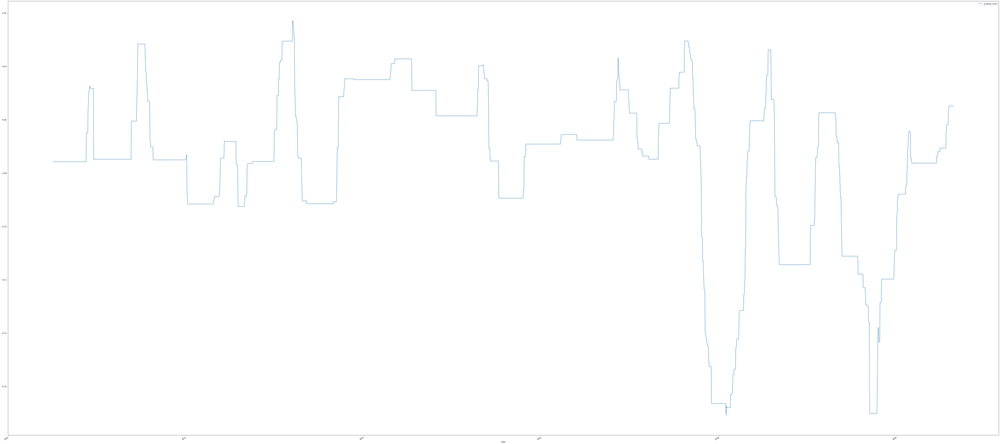

max dd: -0.17088671955294554
IR
Date
2010-12-31         NaN
2011-12-31    2.098561
2012-12-31    2.855166
2013-12-31    1.919473
2014-12-31   -0.523498
2015-12-31    0.991154
2016-12-31    3.545410
2017-12-31   -0.714435
2018-12-31   -4.223109
2019-12-31    2.164181
2020-12-31   -2.815372
Freq: A-DEC, dtype: float64
0.5297530322347423


In [20]:
performance_analysis(mthd2_quantile_port)

In [21]:
df_port.columns.tolist()

['ticker',
 '5dtrend_p_val',
 '5dtrend_t_val',
 'Close',
 'mthd1_signal',
 'mthd2_signal',
 'mthd3_signal',
 'prev_5dtrend_t_val',
 'prob_etf_pipe_sec',
 'prob_sec_pipe_etf',
 'r',
 'ret',
 'u',
 'v',
 'z_r']

/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys


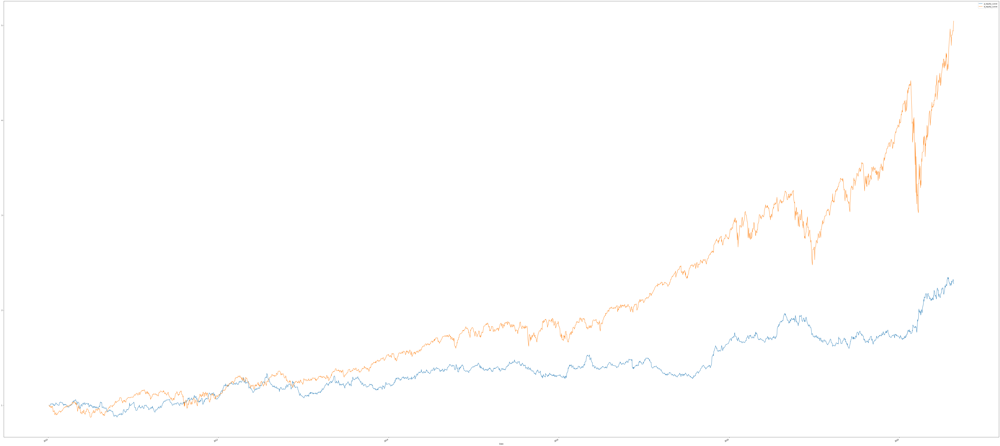

In [22]:
## mthd3 factor portfolio
## df[f"5dtrend_p_val {ticker}"]*df[f"prev_5dtrend_t_val {ticker}"] for mthd3


port_rets =[]
cached_w = df_port.loc[date][['ticker']].set_index('ticker')
cached_w['w'] = 0
cached_w = cached_w.squeeze()


for date in df_port.index.unique():
    ret = df_port.loc[date][['ticker','ret']]
    etf_ret = ret[ret['ticker']=='XLK']['ret'].values[0]
    port_ret = np.sum((ret.set_index('ticker').squeeze().rename(date)- etf_ret)*cached_w)
    
    port_rets.append(port_ret)
    
    df[f"5dtrend_p_val {ticker}"]*df[f"prev_5dtrend_t_val {ticker}"]
    contra_trend = df_port.loc[date][['ticker',f"5dtrend_p_val"]].set_index('ticker').squeeze().rename(date) * df_port.loc[date][['ticker',f"prev_5dtrend_t_val"]].set_index('ticker').squeeze().rename(date)
    
    cached_w = wQuantilePort(contra_trend)
    

mthd3_quantile_port =  pd.DataFrame(index=df_port.index.unique())   
mthd3_quantile_port['port_ret'] = port_rets
mthd3_quantile_port['port_ret'] = mthd3_quantile_port['port_ret'].fillna(0)



mthd3_quantile_port['b_ret'] =df['ret XLK'].fillna(0)



mthd3_quantile_port['p_equity_curve'] = (mthd3_quantile_port['port_ret'] + 1).cumprod()
mthd3_quantile_port['b_equity_curve'] =(mthd3_quantile_port['b_ret'] + 1).cumprod()

mthd3_quantile_port[['p_equity_curve','b_equity_curve']].plot(figsize=(100,50), legend=True)

Ending Equity/ Profitability
Date
2020-08-21    2.278215
Name: p_equity_curve, dtype: float64


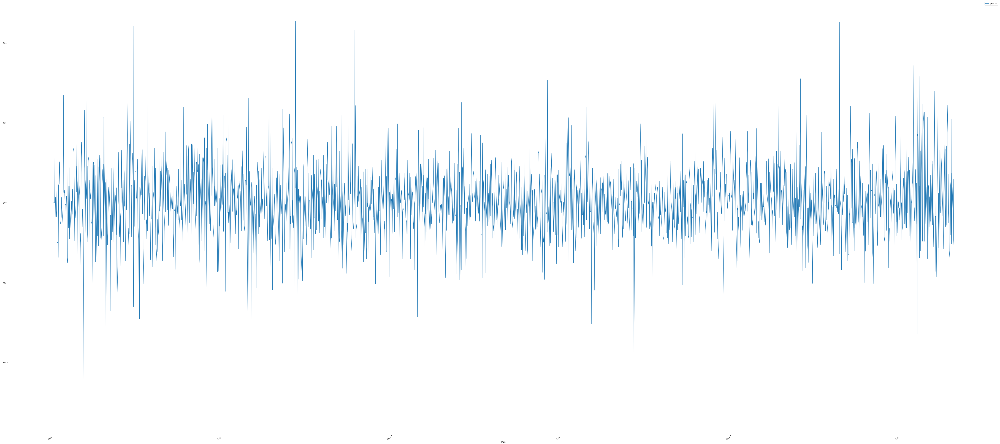

count    2678.000000
mean        0.000347
std         0.008905
min        -0.053265
25%        -0.004734
50%         0.000154
75%         0.005445
max         0.045535
Name: port_ret, dtype: float64
strategy alpha beta
                            OLS Regression Results                            
Dep. Variable:               port_ret   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.6892
Date:                Sat, 22 Aug 2020   Prob (F-statistic):              0.406
Time:                        07:53:05   Log-Likelihood:                 8844.1
No. Observations:                2678   AIC:                        -1.768e+04
Df Residuals:                    2676   BIC:                        -1.767e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                 

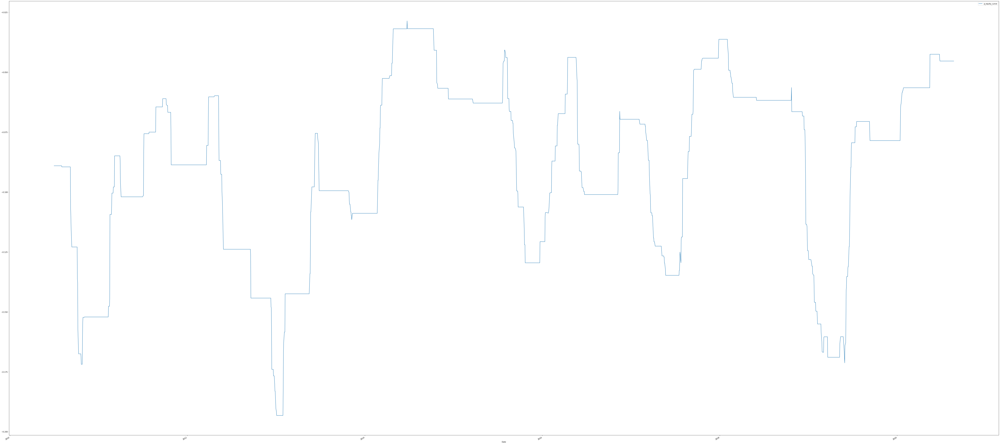

max dd: -0.19323097804954503
IR
Date
2010-12-31         NaN
2011-12-31   -0.747213
2012-12-31    0.435186
2013-12-31   -3.179335
2014-12-31   -1.184580
2015-12-31   -0.346196
2016-12-31   -1.443328
2017-12-31   -0.426278
2018-12-31   -2.074723
2019-12-31    1.309883
2020-12-31   -4.139867
Freq: A-DEC, dtype: float64
-1.1796450661076452


In [23]:
performance_analysis(mthd3_quantile_port)

In [32]:
## XGB Portfolio
## we can train a ML model to decide which pair to trade on using all our current features
## however it also means we need to label our trades, based on our binary signals, which could be only few
## we can do this by taking the first difference of the portfolio holding and only keep those are not 0 to show entry and exit of the trades




## labelling fwd returns of different methods

bt_df_xgb = df.copy()
for ticker in sec_ticker:
    for mthdn in [f"mthd{n}" for n in range(1,4)]:
    
        bt_df_xgb[f"holding {ticker}"] = bt_df_xgb[f"{mthdn}_signal {ticker}"].ffill().shift(1)
        # print(ticker)
        price = bt_df_xgb.loc[(bt_df_xgb[f"holding {ticker}"].diff()!=0)&(bt_df_xgb[f"holding {ticker}"].notnull())][[f"Close {ticker}", f"holding {ticker}"]].reset_index()
        
        price[f"tgt_ret_{mthdn} {ticker}"] = price[f"Close {ticker}"].pct_change(1)*price[f"holding {ticker}"]
        

        bt_df_xgb[f"tgt_ret_{mthdn} {ticker}"] = price[['Date',f"tgt_ret_{mthdn} {ticker}"]].shift(-1).set_index('Date')
        
        bt_df_xgb[f"tgt_ret_{mthdn} {ticker}"] = bt_df_xgb[f"tgt_ret_{mthdn} {ticker}"].fillna(0)


        
bt_df_xgb.columns = bt_df_xgb.columns.str.split(' ', expand=True)  
bt_df_xgb = bt_df_xgb.stack()
bt_df_xgb = bt_df_xgb.reset_index(level=[0,1])
bt_df_xgb.rename({'level_1':'ticker'}, axis='columns', inplace=True)
bt_df_xgb.set_index('Date', inplace=True)


bt_df_xgb
    
    
    

,ticker,5dtrend_p_val,5dtrend_t_val,Close,holding,mthd1_signal,mthd2_signal,mthd3_signal,prev_5dtrend_t_val,prob_etf_pipe_sec,prob_sec_pipe_etf,r,ret,tgt_ret_mthd1,tgt_ret_mthd2,tgt_ret_mthd3,u,v,z_r
Date,,,,,,,,,,,,,,,,,,,
2010-01-04,AAPL,NaN,NaN,30.57,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,0.388277,NaN,0.0,0.0,0.000000,1.000000,1.000000,NaN
2010-01-04,ACN,NaN,NaN,42.07,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,0.060673,NaN,0.0,0.0,0.000000,1.000000,1.000000,NaN
2010-01-04,ADBE,NaN,NaN,37.09,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,0.133096,NaN,0.0,0.0,0.000000,1.000000,1.000000,NaN
2010-01-04,AMZN,NaN,NaN,133.90,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,0.221292,NaN,0.0,0.0,0.000000,1.000000,1.000000,NaN
2010-01-04,AVGO,NaN,NaN,18.86,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,0.757512,NaN,0.0,0.0,0.000000,1.000000,1.000000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-08-21,PYPL,0.252827,1.411904,196.57,1.0,NaN,1.0,-1.0,-0.019839,0.990967,0.002457,-0.384200,-0.008124,0.0,0.0,0.021461,0.123226,0.799851,0.201605
2020-08-21,QCOM,0.016751,4.847642,112.03,-1.0,NaN,NaN,NaN,7.638754,0.627574,0.664470,0.458540,0.012380,0.0,0.0,0.000000,0.815907,0.799851,-0.476485
2020-08-21,TXN,0.039304,3.506239,139.19,-1.0,NaN,1.0,NaN,1.710969,0.750847,0.311669,0.156301,0.004474,0.0,0.0,-0.005127,0.619866,0.799851,0.831586


In [33]:
bt_df_xgb.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 56238 entries, 2010-01-04 to 2020-08-21
Data columns (total 19 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ticker              56238 non-null  object 
 1   5dtrend_p_val       49247 non-null  float64
 2   5dtrend_t_val       49247 non-null  float64
 3   Close               52005 non-null  float64
 4   holding             49201 non-null  float64
 5   mthd1_signal        11301 non-null  float64
 6   mthd2_signal        39768 non-null  float64
 7   mthd3_signal        30224 non-null  float64
 8   prev_5dtrend_t_val  49227 non-null  float64
 9   prob_etf_pipe_sec   53560 non-null  float64
 10  prob_sec_pipe_etf   53560 non-null  float64
 11  r                   49327 non-null  float64
 12  ret                 51984 non-null  float64
 13  tgt_ret_mthd1       53560 non-null  float64
 14  tgt_ret_mthd2       53560 non-null  float64
 15  tgt_ret_mthd3       53560 non-null  

In [34]:
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from xgboost import XGBClassifier

def make_model(mtrain_X, mtrain_y, mtest_X):
    categorical_features = mtrain_X.columns[(mtrain_X.dtypes.values != np.dtype('float64'))].tolist()
    numeric_features = mtrain_X.columns[(mtrain_X.dtypes.values == np.dtype('float64'))].tolist()

    numeric_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='median')), ('scalar', StandardScaler())])

    categorical_transfomer = Pipeline(steps=[('imputer', SimpleImputer(strategy='constant', fill_value='missing')),
                                           ('onehot_sparse', OneHotEncoder(handle_unknown='ignore'))])

    preprocessor = ColumnTransformer(
        transformers=[
            ('num', numeric_transformer, numeric_features),
            ('cat', categorical_transfomer, categorical_features)
        ]
    )

    params ={'num_class': 3, 'objective': 'multi:softprob'}
    
    
    clf = Pipeline(steps=[('preprocessor', preprocessor),
                          ('classifier', XGBClassifier(params=params))])

    clf.fit(mtrain_X, mtrain_y)

    pred_y = clf.predict(mtest_X)
    
    try:
    
        onehot_columns =clf.named_steps['preprocessor'].named_transformers_['cat'].named_steps['onehot_sparse'].get_feature_names(input_features=categorical_features)


        feature_importance = pd.Series(data=clf.named_steps['classifier'].feature_importances_, index=np.append(numeric_features, onehot_columns))

        feature_importance = feature_importance.sort_values(ascending=False)
    except:
        feature_importance = None
    return pred_y, feature_importance




In [35]:
## we split first 5 years as training, rest for testing
from sklearn.metrics import classification_report, confusion_matrix




temp_xgb_df = bt_df_xgb.copy()

for mthdn in [f"mthd{n}" for n in range(1,4)]:
    xgb_df = temp_xgb_df.copy()

    xgb_df = xgb_df[xgb_df['ticker']!='XLK']
    xgb_df['ticker'] = xgb_df['ticker'].astype('category')
    
    xgb_df[f"tgt_ret_{mthdn}"] = np.sign(xgb_df[f"tgt_ret_{mthdn}"])

    train_X, test_X = xgb_df[xgb_df.index <='2015-01-01'],xgb_df[xgb_df.index >'2015-01-01']
    
    
    
    train_y = train_X.pop(f"tgt_ret_{mthdn}")
    test_y = test_X.pop(f"tgt_ret_{mthdn}")
    

    
    train_X.drop([col for col in train_X.columns if "tgt_ret_" in col], axis=1, inplace=True)
    
    
    
    pred_y, feature_importance = make_model(train_X, train_y, test_X)
    
    test_X[f"xgb_{mthdn}"] = pred_y
    bt_df_xgb = pd.merge(bt_df_xgb, test_X[[f"xgb_{mthdn}", "ticker"]], left_on=['Date', 'ticker'], right_on=['Date', 'ticker'], how='left')
    
    print(confusion_matrix(test_y, pred_y, labels=[-1, 0, 1]))
        



/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,
/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/sklearn/compose/_column_transformer.py:430: FutureWarning: Given feature/column names or counts do not match the ones for the data given during fit. This will fail from v0.24.
  FutureWarning)
/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/kingf.w

[[    0   380     0]
 [    0 27780     0]
 [    0   240     0]]


/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/sklearn/compose/_column_transformer.py:430: FutureWarning: Given feature/column names or counts do not match the ones for the data given during fit. This will fail from v0.24.
  FutureWarning)
/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


[[    9  4695     0]
 [    5 19176     8]
 [    1  4506     0]]


/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/sklearn/compose/_column_transformer.py:430: FutureWarning: Given feature/column names or counts do not match the ones for the data given during fit. This will fail from v0.24.
  FutureWarning)


[[    4  2873     0]
 [    4 22590     1]
 [    2  2926     0]]


/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [36]:
feature_importance

prob_sec_pipe_etf     0.171608
prev_5dtrend_t_val    0.146562
5dtrend_p_val         0.129018
holding               0.111175
u                     0.090156
ret                   0.088733
mthd3_signal          0.082304
z_r                   0.074151
5dtrend_t_val         0.014314
v                     0.012645
r                     0.012404
prob_etf_pipe_sec     0.011356
Close                 0.010584
ticker_CRM            0.008562
ticker_AMZN           0.008134
ticker_MSFT           0.007206
ticker_INTC           0.006683
ticker_TXN            0.005948
ticker_AVGO           0.004654
ticker_CSCO           0.002038
ticker_AAPL           0.001765
mthd2_signal          0.000000
mthd1_signal          0.000000
ticker_V              0.000000
ticker_ACN            0.000000
ticker_BABA           0.000000
ticker_FB             0.000000
ticker_GOOG           0.000000
ticker_IBM            0.000000
ticker_MA             0.000000
ticker_NVDA           0.000000
ticker_ORCL           0.000000
ticker_P

/Users/kingf.wong/.conda/envs/FinanceML/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys


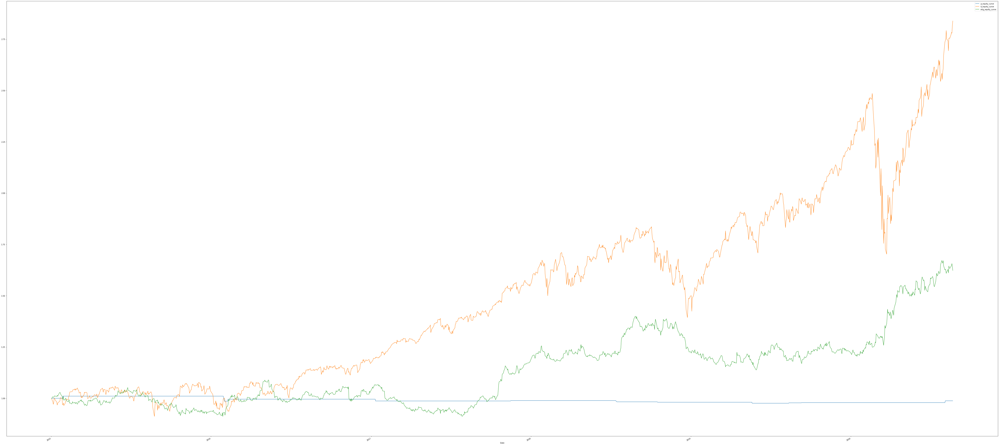

In [37]:
## seems like no model willing to make a bet
## let's backtest mthd3 as an example, only for the testing period
## instead of taking the quantile, we take equal weight



bt_df_xgb = bt_df_xgb[bt_df_xgb.index >'2015-01-01']

port_rets =[]
cached_w = bt_df_xgb.loc[date][['ticker']].set_index('ticker')
cached_w['w'] = 0
cached_w = cached_w.squeeze()


for date in bt_df_xgb.index.unique():
    ret = df_port.loc[date][['ticker','ret']]
    etf_ret = ret[ret['ticker']=='XLK']['ret'].values[0]
    port_ret = np.sum((ret.set_index('ticker').squeeze().rename(date)- etf_ret)*cached_w)
    
    port_rets.append(port_ret)
    
    xgb_signal = bt_df_xgb.loc[date][['ticker','xgb_mthd3']].set_index('ticker').squeeze().rename(date)
    
    cached_w = wEqualPort(xgb_signal)
    

mthd3_eqw_port =  pd.DataFrame(index=bt_df_xgb.index.unique())  
mthd3_eqw_port['port_ret'] = port_rets
mthd3_eqw_port['port_ret'] = mthd3_eqw_port['port_ret'].fillna(0)


mthd3_eqw_port['b_ret'] =df['ret XLK'].fillna(0)



mthd3_eqw_port['p_equity_curve'] = (mthd3_eqw_port['port_ret'] + 1).cumprod()
mthd3_eqw_port['b_equity_curve'] =(mthd3_eqw_port['b_ret'] + 1).cumprod()
mthd3_eqw_port['orig_ret'] = mthd3_quantile_port['port_ret'] 
mthd3_eqw_port['orig_equity_curve'] =(mthd3_eqw_port['orig_ret'] + 1).cumprod()

mthd3_eqw_port[['p_equity_curve','b_equity_curve','orig_equity_curve']].plot(figsize=(100,50), legend=True)





Ending Equity/ Profitability
Date
2020-08-21    0.987755
Name: p_equity_curve, dtype: float64


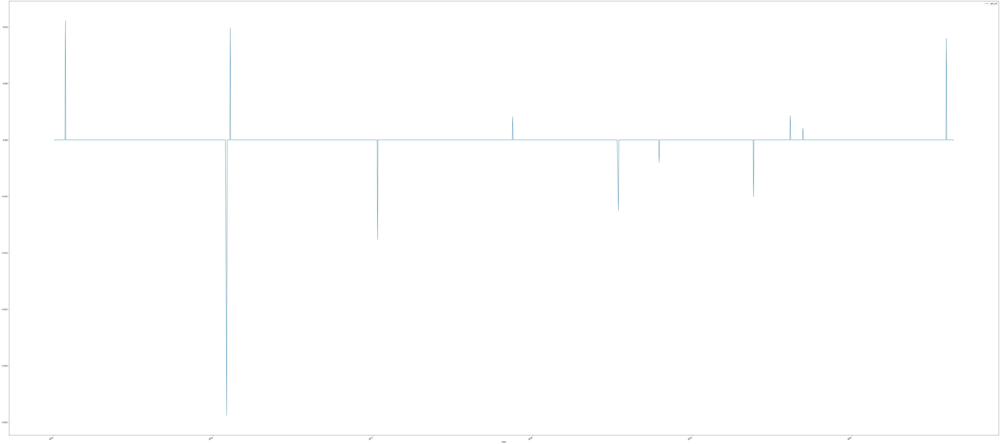

count    1420.000000
mean       -0.000008
std         0.000857
min        -0.024404
25%         0.000000
50%         0.000000
75%         0.000000
max         0.010538
Name: port_ret, dtype: float64
strategy alpha beta
                            OLS Regression Results                            
Dep. Variable:               port_ret   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.05246
Date:                Sat, 22 Aug 2020   Prob (F-statistic):              0.819
Time:                        08:00:25   Log-Likelihood:                 8014.2
No. Observations:                1420   AIC:                        -1.602e+04
Df Residuals:                    1418   BIC:                        -1.601e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                 

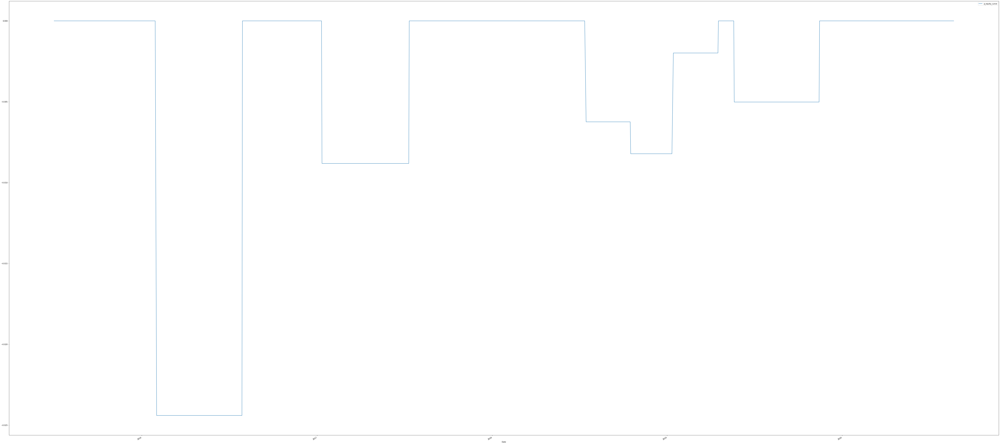

max dd: -0.024403855273572028
IR
Date
2015-12-31           NaN
2016-12-31     -2.049076
2017-12-31    -44.293329
2018-12-31    -82.850468
2019-12-31      9.256650
2020-12-31   -130.624399
Freq: A-DEC, dtype: float64
-50.11212431805483


In [38]:
performance_analysis(mthd3_eqw_port)

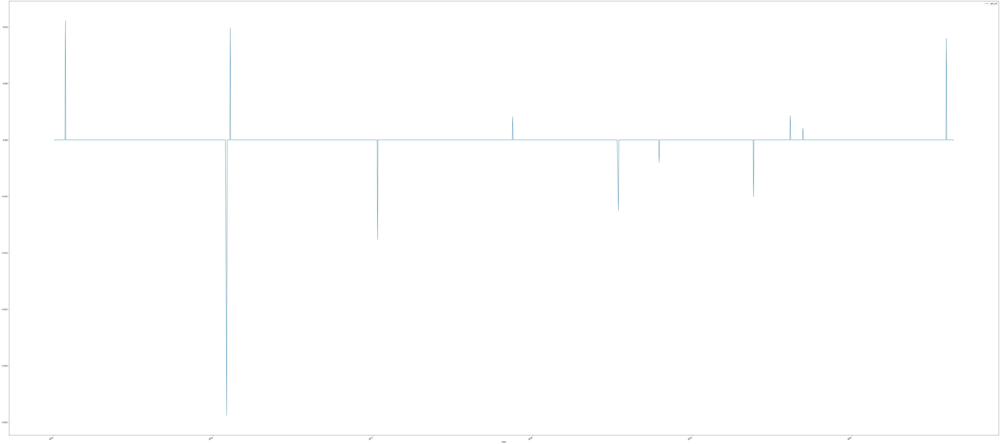

In [39]:
mthd3_eqw_port['port_ret'].plot(figsize=(100,50), legend=True)